In [1]:
import sys
sys.path.append("../")

In [4]:
import pandas as pd
import plotly.graph_objects as go
from technicals.indicators import RSI
from technicals.patterns import apply_patterns
from plotting import CandlePlot
import numpy as np

from infrastructure.quotehistory_collection import quotehistoryCollection as qc
from simulation.ema_cross_multi_temporal_2_tester import EmaCrossMultiTemporal2Tester
from simulation.ema_cross_multi_temporal_3_tester import EmaCrossMultiTemporal3Tester
from simulation.ema_cross_multi_temporal_3_tester_fast import EmaCrossMultiTemporal3TesterFast
from simulation.donchian_multi_temporal_4_tester import DonchianMultiTemporal4Tester
from simulation.donchian_multi_temporal_7_tester import DonchianMultiTemporal7Tester
from simulation.donchian_trend_binance import DonchianTrend
# from simulation.donchian_multi_temporal_9_tester import DonchianMultiTemporal9Tester

In [5]:


# Função para calcular a EMA
def calculate_ema(data, period):
    return data.ewm(span=period, adjust=False).mean()



In [6]:

BUY_REVERSE = 1
SELL_REVERSE = -1
BUY_TREND = 2
SELL_TREND = -2
NONE = 0

def apply_donchian_reverse(row,spread=50):
    if row.SPREAD < spread and row.DELTA_DONCHIAN_HIGH < 0 and row.DELTA_DONCHIAN_HIGH_PREV >= 0:
        return SELL_REVERSE
    elif row.SPREAD < spread and row.DELTA_DONCHIAN_LOW > 0 and row.DELTA_DONCHIAN_LOW_PREV <= 0:
        return BUY_REVERSE
    return NONE
    
def apply_donchian_trend(row,spread=50):
    if row.SPREAD < spread and row.DELTA_DONCHIAN_HIGH > 0 and row.DELTA_DONCHIAN_HIGH_PREV <= 0:
        return BUY_TREND
    elif row.SPREAD < spread and row.DELTA_DONCHIAN_LOW < 0 and row.DELTA_DONCHIAN_LOW_PREV >= 0:
        return SELL_TREND
    return NONE


In [14]:
def run_pair(pair,pip_value,granularity='M5',use_spread=True,
             stop_loss = 1000, take_profit = 200, 
             fixed_tp_sl=True,trans_cost=8,
             neg_multiplier=1.5, rev=True,
            spread_limit=50,ema_1 = 10,donchian_window = 10000, donchian_window_prev = 100):
    df = pd.read_pickle(f"../data/{granularity}/{pair}_{granularity}.pkl")
    df.reset_index(drop=True, inplace=True)

    df[f'EMA_short'] = df.mid_c.ewm(span=ema_1, min_periods=ema_1).mean()

    df[f'EMA_{ema_1}'] = df.mid_c.ewm(span=ema_1, min_periods=ema_1).mean()

    df['donchian_high'] = df['mid_c'].rolling(window=donchian_window).max()
    df['donchian_low'] = df['mid_c'].rolling(window=donchian_window).min()
    df['donchian_mid'] = (df['donchian_high'] + df['donchian_low']) / 2
    df['donchian_75'] = (df['donchian_high'] + df['donchian_mid']) / 2
    df['donchian_87'] = (df['donchian_high'] + df['donchian_75']) / 2
    df['donchian_62'] = (df['donchian_75'] + df['donchian_mid']) / 2
    df['donchian_25'] = (df['donchian_mid'] + df['donchian_low']) / 2
    df['donchian_37'] = (df['donchian_mid'] + df['donchian_25']) / 2
    df['donchian_12'] = (df['donchian_25'] + df['donchian_low']) / 2
    
    df['SPREAD'] = (df[f'ask_c'] - df[f'bid_c']) / pip_value

    df['donchian_size'] = (df['donchian_high'] - df['donchian_low'])/pip_value
    
    df['TP'] = 0
    df['SL'] = 0
    
    df_slim = df.copy()
    df_slim.dropna(inplace=True)
    df_slim.reset_index(drop=True, inplace=True)

    gt = DonchianTrend(
        df_slim,
        pip_value,
        use_spread=use_spread,
        LOSS_FACTOR = stop_loss,
        PROFIT_FACTOR = take_profit,
        fixed_tp_sl=fixed_tp_sl,
        trans_cost=trans_cost,
        neg_multiplier=neg_multiplier,
        rev=rev,
        spread_limit=spread_limit,
        donchian_window_prev = donchian_window_prev
    )
    
    gt.run_test()
    return gt

In [15]:

pairs_pip_size = {
    "XAUUSD": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 10
    },
    "XAUUSD2": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 10
    },
    "XAUUSD3": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 10
    }
}

In [16]:
%%time


import warnings
warnings.filterwarnings('ignore')


qc.LoadQuotehistory("../data")

# SL = [1000,2000,3000,4000]
# TP = [100,200,300,500,1000]

SL = [50000]
TP = [50000]
neg_multiplier = 1
rev=False

res = []

for es in [200]:
    for dw in [1500]:
        for dwp in [50]:
            print("")
            print("#######################################")
            print("")
            print(f"Ema short = {es} | Donchian Window = {dw} | donchian_window_prev = {dwp}")
            print("")
            for pair in pairs_pip_size:
                # if pair in qc.quotehistory_dict.keys():
                print(f" Pair ---------> {pair}")
                pip_size = pairs_pip_size[pair]['pip_value']
                for sl in SL:
                    for tp in TP:
                        print(f"SL => {sl} | TP => {tp}")
                        res.append(
                            dict(
                                pair=pair,
                                stop_loss=sl,
                                take_profit=tp,
                                res=run_pair(
                                    pair,
                                    pip_size,
                                    granularity='M1',
                                    use_spread=True,
                                    stop_loss=sl,
                                    take_profit=tp,
                                    fixed_tp_sl=True,
                                    trans_cost=pairs_pip_size[pair]['trans_cost'],
                                    neg_multiplier=neg_multiplier,
                                    rev=rev,
                                    spread_limit=pairs_pip_size[pair]['spread'],
                                    ema_1=es,
                                    donchian_window = dw,
                                    donchian_window_prev = dwp
                                )
                            )
                        )
                            


#######################################

Ema short = 200 | Donchian Window = 1500 | donchian_window_prev = 50

 Pair ---------> XAUUSD
SL => 50000 | TP => 50000

Result: 286047.0
Len loss:  0
Len Open: 5
Len Close: 232
Len Pos 177
Len Neg 55
Res pos 547828.9999999998
Res neg 261781.99999999977
Rel len pos neg 0.7629310344827587
Rel len neg pos 0.23706896551724138
Rel pos neg 0.6766570612306405
Rel neg pos 0.3233429387693595

 Pair ---------> XAUUSD2
SL => 50000 | TP => 50000

Result: 190760.00000000003
Len loss:  18
Len Open: 2
Len Close: 326
Len Pos 232
Len Neg 94
Res pos 620730.0
Res neg 429970.0000000001
Rel len pos neg 0.7116564417177914
Rel len neg pos 0.2883435582822086
Rel pos neg 0.5907775768535262
Rel neg pos 0.4092224231464739

 Pair ---------> XAUUSD3
SL => 50000 | TP => 50000

Result: -7297.999999999851
Len loss:  18
Len Open: 2
Len Close: 174
Len Pos 112
Len Neg 62
Res pos 138530.0
Res neg 145827.99999999983
Rel len pos neg 0.6436781609195402
Rel len neg pos 0.35632183908

In [9]:
df = res[0]['res'].df.copy()
print(df.columns)
df.describe()

Index(['time', 'bid_o', 'bid_h', 'bid_l', 'bid_c', 'ask_o', 'ask_h', 'ask_l',
       'ask_c', 'mid_o', 'mid_h', 'mid_l', 'mid_c', 'EMA_short', 'EMA_50',
       'donchian_high', 'donchian_low', 'donchian_mid', 'donchian_75',
       'donchian_87', 'donchian_62', 'donchian_25', 'donchian_37',
       'donchian_12', 'SPREAD', 'donchian_size', 'TP', 'SL', 'SIGNAL_UP',
       'SIGNAL_DOWN'],
      dtype='object')


,time,bid_o,bid_h,bid_l,bid_c,ask_o,ask_h,ask_l,ask_c,mid_o,...,donchian_62,donchian_25,donchian_37,donchian_12,SPREAD,donchian_size,TP,SL,SIGNAL_UP,SIGNAL_DOWN
count,498631,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,...,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000,498631.000000
mean,2021-05-10 22:03:46.595417856,1.122149,1.122335,1.121963,1.122149,1.122178,1.122363,1.121992,1.122178,1.122164,...,1.123401,1.119856,1.121037,1.118674,0.292374,94.546295,0.000500,0.000339,0.000628,0.001005
min,2018-01-03 17:35:00,0.954000,0.954580,0.953620,0.953980,0.954000,0.954620,0.953630,0.953990,0.954000,...,0.961701,0.957071,0.958614,0.955528,-16.900000,19.550000,-4.009960,-4.013860,0.000000,0.000000
25%,2019-09-04 19:02:30,1.084150,1.084310,1.083970,1.084150,1.084170,1.084330,1.084000,1.084170,1.084160,...,1.085329,1.082016,1.083117,1.081011,0.000000,64.250000,0.000000,0.000000,0.000000,0.000000
50%,2021-05-12 01:20:00,1.116580,1.116740,1.116430,1.116580,1.116630,1.116780,1.116480,1.116630,1.116610,...,1.117529,1.114534,1.115634,1.113506,0.200000,85.600000,0.000000,0.000000,0.000000,0.000000
75%,2023-01-13 01:57:30,1.167490,1.167675,1.167300,1.167490,1.167500,1.167690,1.167310,1.167500,1.167500,...,1.168756,1.165016,1.166265,1.163635,0.400000,114.500000,0.000000,0.000000,0.000000,0.000000
max,2024-09-16 14:40:00,1.255310,1.255540,1.254900,1.255310,1.255310,1.255540,1.254900,1.255310,1.255310,...,1.251155,1.247000,1.248385,1.245615,47.700000,426.500000,6.253830,6.247970,7.000000,9.000000
std,NaN,0.057244,0.057234,0.057254,0.057244,0.057242,0.057232,0.057252,0.057242,0.057243,...,0.057080,0.057337,0.057246,0.057433,0.616239,44.446828,0.099936,0.098029,0.060495,0.085070


In [10]:
df.SIGNAL_UP.value_counts()

SIGNAL_UP
0    498534
1        61
7        36
Name: count, dtype: int64

In [11]:
for r in res:
    print(r['pair'], r['res'].df_results.result.sum())

EURUSD 7437.900000000008


In [12]:
# df['SIGNAL_UP'].value_counts()

In [13]:
# df['SIGNAL_DOWN'].value_counts()

In [14]:
df_results = res[0]['res'].df_results
pair = res[0]['pair']
print(pair)
# print(df_results.columns)
res_pos = df_results[df_results['result'] > 0]
res_neg = df_results[df_results['result'] < 0]
df_results.shape, res_pos.shape, res_neg.shape

EURUSD


((85, 18), (54, 18), (31, 18))

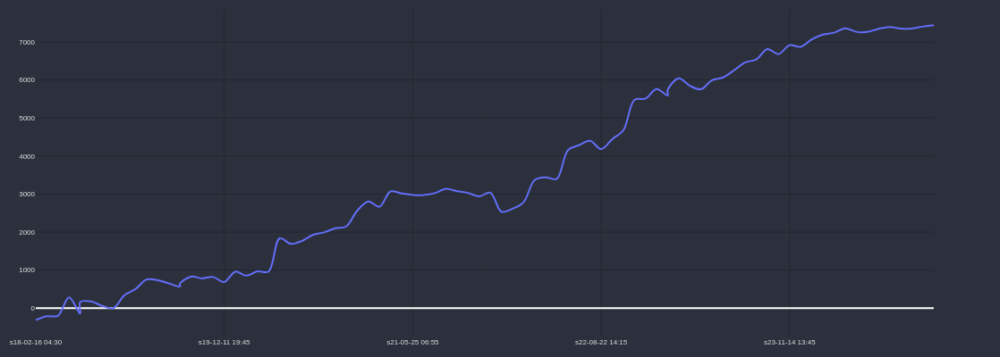

In [15]:

df_results['time'] = df_results['end_time']
df_results['GAIN_C'] = df_results.result.cumsum()

cp = CandlePlot(df_results, candles=False)
cp.show_plot(line_traces = ['GAIN_C'])

In [16]:
df_results.iloc[1120:1125]

,running,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,TP,SL,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C


In [17]:
# res_neg.describe()

In [18]:
# res_neg.head()

In [19]:
# res_pos.describe()


In [20]:
# df_results.columns, df_results.shape[0]

In [21]:
# res_neg['SIGNAL_UP'].value_counts(), res_neg['SIGNAL_DOWN'].value_counts()


In [22]:
# res_pos['SIGNAL_UP'].value_counts(), res_pos['SIGNAL_DOWN'].value_counts()

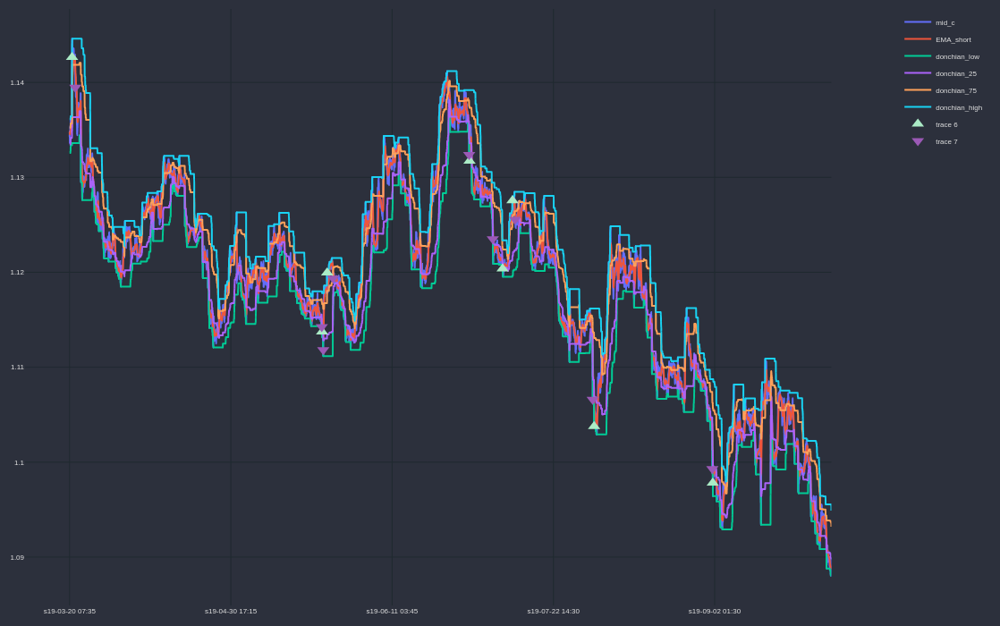

In [28]:

cp = CandlePlot(df.iloc[90000:130000],candles=False)


trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP != 0]
trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN != 0]
marker_trade_up = '#abebc6'
marker_trade_down = '#9b59b6'

# trades

markers = 'mid_c'


cp.add_traces(['mid_c',"EMA_short",'donchian_low','donchian_25',
               'donchian_75','donchian_high',])


# SIGNAL UP DOWN
cp.fig.add_trace(go.Scatter(
    x = trades_up.sTime,
    y = trades_up[markers],
    mode = 'markers',
    marker_symbol = 'triangle-up',
    marker=dict(color=marker_trade_up, size=12)
))
cp.fig.add_trace(go.Scatter(
    x = trades_down.sTime,
    y = trades_down[markers],
    mode= 'markers',
    marker_symbol = 'triangle-down',
    marker=dict(color=marker_trade_down, size=12)
))

cp.show_plot(height=700)

In [24]:
df_results[df_results['start_time'] == '2018-10-30 20:10:00']

,running,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,TP,SL,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C


In [32]:
df[df['time'] == '2018-10-30 20:10:00']

,time,bid_o,bid_h,bid_l,bid_c,ask_o,ask_h,ask_l,ask_c,mid_o,...,donchian_62,donchian_25,donchian_37,donchian_12,SPREAD,donchian_size,TP,SL,SIGNAL_UP,SIGNAL_DOWN
61626,2018-10-30 20:10:00,0.89338,0.89367,0.89326,0.89353,0.89338,0.89367,0.89326,0.89353,0.89338,...,0.89124,0.88863,0.8895,0.88776,0.0,69.6,0.0,0.0,0,0


In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Função para calcular drawdown
def calcular_drawdown(df):
    """Calcula o maior drawdown, considerando o menor valor subsequente ao pico."""
    max_pico = df['accumulated_pips'].cummax()
    drawdown = max_pico - df['accumulated_pips']
    return drawdown.max()

# Função para calcular sequências de ganhos e perdas consecutivas
def calcular_sequencia_ganhos_perdas(df):
    """Calcula a quantidade de ganhos e perdas consecutivas."""
    df['result_positive'] = df['result'] > 0
    df['sequencia'] = (df['result_positive'] != df['result_positive'].shift(1)).cumsum()
    sequencias = df.groupby(['sequencia', 'result_positive']).size().reset_index(name='count')
    
    ganhos_consecutivos = sequencias[sequencias['result_positive'] == True]['count'].max()
    perdas_consecutivas = sequencias[sequencias['result_positive'] == False]['count'].max()
    
    return ganhos_consecutivos, perdas_consecutivas

# Função principal para gerar o relatório completo
def gerar_relatorio_completo(df):
    sns.set(style="whitegrid")
    
    # Formatação textual para o notebook
    def format_section(title):
        print("#" * 60)
        print(f"# {title}")
        print("#" * 60, "\n")
    
    format_section("1. Análise de Desempenho por Tipo de Fechamento (Trigger Type)")
    
    trigger_counts = df['trigger_type'].value_counts(normalize=True) * 100
    trigger_means = df.groupby('trigger_type')['result'].mean()
    trigger_durations = df.groupby('trigger_type')['count'].mean()
    
    print(f"Distribuição de operações por tipo de fechamento (em %):\n{trigger_counts}\n")
    print(f"Média de pips ganhos/perdidos por tipo de fechamento:\n{trigger_means}\n")
    print(f"Tempo médio (em candles) das operações por tipo de fechamento:\n{trigger_durations}\n")
    
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='trigger_type', palette='viridis')
    plt.title("Frequência de Operações por Tipo de Fechamento")
    plt.xlabel("Tipo de Fechamento")
    plt.ylabel("Número de Operações")
    plt.show()

    format_section("2. Análise de Rentabilidade por Compra e Venda (SIGNAL_UP e SIGNAL_DOWN)")
    
    # Análise para compras (coluna SIGNAL_UP)
    signal_up_counts = df['SIGNAL_UP'].value_counts(normalize=True) * 100
    signal_up_means = df.groupby('SIGNAL_UP')['result'].mean()
    signal_up_durations = df.groupby('SIGNAL_UP')['count'].mean()

    print(f"Distribuição de operações de compra (em %):\n{signal_up_counts}\n")
    print(f"Média de pips ganhos/perdidos em operações de compra:\n{signal_up_means}\n")
    print(f"Tempo médio (em candles) das operações de compra:\n{signal_up_durations}\n")

    # Análise para vendas (coluna SIGNAL_DOWN)
    signal_down_counts = df['SIGNAL_DOWN'].value_counts(normalize=True) * 100
    signal_down_means = df.groupby('SIGNAL_DOWN')['result'].mean()
    signal_down_durations = df.groupby('SIGNAL_DOWN')['count'].mean()

    print(f"Distribuição de operações de venda (em %):\n{signal_down_counts}\n")
    print(f"Média de pips ganhos/perdidos em operações de venda:\n{signal_down_means}\n")
    print(f"Tempo médio (em candles) das operações de venda:\n{signal_down_durations}\n")

    format_section("3. Rentabilidade por Compra e Venda com relação ao Tipo de Fechamento")
    
    for trigger in df['trigger_type'].unique():
        print(f"Trigger Type {trigger}:")
        group_up = df[df['trigger_type'] == trigger].groupby('SIGNAL_UP')['result'].mean()
        group_down = df[df['trigger_type'] == trigger].groupby('SIGNAL_DOWN')['result'].mean()
        print(f"  Compra (SIGNAL_UP): {group_up.get(1, 'N/A')}")
        print(f"  Venda (SIGNAL_DOWN): {group_down.get(1, 'N/A')}")
        print()

    format_section("4. Tempo médio de operação e impacto nos resultados")
    
    signal_trigger_durations = df.groupby(['SIGNAL_UP', 'trigger_type'])['count'].mean()
    print(f"Tempo médio de operação por tipo de fechamento e compra:\n{signal_trigger_durations}\n")
    
    signal_trigger_durations_down = df.groupby(['SIGNAL_DOWN', 'trigger_type'])['count'].mean()
    print(f"Tempo médio de operação por tipo de fechamento e venda:\n{signal_trigger_durations_down}\n")

    format_section("5. Análise de Volatilidade e Duração das Operações (Count)")
    
    count_result_corr = df[['count', 'result']].corr().iloc[0, 1]
    print(f"Correlação entre a duração das operações (candles) e o resultado: {count_result_corr}\n")

    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=df, x='count', y='result', hue='trigger_type', palette='coolwarm')
    plt.title("Duração das Operações (Candles) vs. Resultado (Pips)")
    plt.xlabel("Duração (Candles)")
    plt.ylabel("Resultado (Pips)")
    plt.show()

    format_section("6. Análise de Drawdown e Recuperação")
    
    df['accumulated_pips'] = df['result'].cumsum()
    max_drawdown = calcular_drawdown(df)
    print(f"Maior drawdown subsequente: {max_drawdown} pips\n")
    
    format_section("7. Análise de Drawdown por Tipo de Fechamento")
    
    for trigger in df['trigger_type'].unique():
        print(f"Trigger Type {trigger}:")
        trigger_df = df[df['trigger_type'] == trigger]
        if not trigger_df.empty:
            drawdown = calcular_drawdown(trigger_df)
            print(f"  Maior drawdown subsequente: {drawdown} pips")
        else:
            print(f"  Nenhuma operação para Trigger Type {trigger}")
        print()

    format_section("8. KPIs Principais")
    
    total_operations = len(df)
    winning_operations = len(df[df['result'] > 0])
    losing_operations = len(df[df['result'] < 0])
    success_rate = (winning_operations / total_operations) * 100
    profit_factor = df[df['result'] > 0]['result'].sum() / abs(df[df['result'] < 0]['result'].sum())
    
    ganhos_consecutivos, perdas_consecutivas = calcular_sequencia_ganhos_perdas(df)

    print(f"Taxa de sucesso: {success_rate:.2f}%")
    print(f"Profit Factor: {profit_factor:.2f}")
    print(f"Maior sequência de ganhos consecutivos: {ganhos_consecutivos}")
    print(f"Maior sequência de perdas consecutivas: {perdas_consecutivas}\n")
    
    format_section("9. Quantidade de Operações com Lucro e Perda")
    
    # Operações com lucro e perda no geral
    total_lucro = len(df[df['result'] > 0])
    total_perda = len(df[df['result'] < 0])
    
    print(f"Total de Operações com Lucro: {total_lucro}")
    print(f"Total de Operações com Perda: {total_perda}\n")
    
    # Por tipo de operação (Compra e Venda)
    print("Por Compra e Venda:")
    for signal in ['SIGNAL_UP', 'SIGNAL_DOWN']:
        lucro = len(df[(df[signal] != 0) & (df['result'] > 0)])
        perda = len(df[(df[signal] != 0) & (df['result'] < 0)])
        operacao = "Compra (SIGNAL_UP)" if signal == 'SIGNAL_UP' else "Venda (SIGNAL_DOWN)"
        print(f"{operacao}:")
        print(f"  Operações com Lucro: {lucro}")
        print(f"  Operações com Perda: {perda}\n")
    
    # Por tipo de fechamento (Trigger Type)
    print("Por Tipo de Fechamento:")
    for trigger in df['trigger_type'].unique():
        lucro = len(df[(df['trigger_type'] == trigger) & (df['result'] > 0)])
        perda = len(df[(df['trigger_type'] == trigger) & (df['result'] < 0)])
        print(f"Trigger Type {trigger}:")
        print(f"  Operações com Lucro: {lucro}")
        print(f"  Operações com Perda: {perda}\n")

    format_section("10. Valor Total de Retorno (Result) por Tipo de Retorno")

    # Valor total de retorno geral
    total_retorno = df['result'].sum()
    print(f"Valor total de retorno geral: {total_retorno} pips\n")

    # Valor total de retorno por tipo de operação (Compra e Venda)
    print("Valor total de retorno por Compra e Venda:")
    for signal in ['SIGNAL_UP', 'SIGNAL_DOWN']:
        total_retorno_signal = df[df[signal] != 0]['result'].sum()
        operacao = "Compra (SIGNAL_UP)" if signal == 'SIGNAL_UP' else "Venda (SIGNAL_DOWN)"
        print(f"{operacao}: {total_retorno_signal} pips\n")

    # Valor total de retorno por tipo de fechamento (Trigger Type)
    print("Valor total de retorno por Tipo de Fechamento:")
    for trigger in df['trigger_type'].unique():
        total_retorno_trigger = df[df['trigger_type'] == trigger]['result'].sum()
        print(f"Trigger Type {trigger}: {total_retorno_trigger} pips\n")

    format_section("11. Retorno Positivo e Negativo por Tipo de Retorno")

    # Retorno positivo e negativo por tipo de operação (Compra e Venda)
    print("Retorno Positivo e Negativo por Compra e Venda:")
    for signal in ['SIGNAL_UP', 'SIGNAL_DOWN']:
        positivo = df[(df[signal] != 0) & (df['result'] > 0)]['result'].sum()
        negativo = df[(df[signal] != 0) & (df['result'] < 0)]['result'].sum()
        operacao = "Compra (SIGNAL_UP)" if signal == 'SIGNAL_UP' else "Venda (SIGNAL_DOWN)"
        print(f"{operacao}:")
        print(f"  Retorno Positivo: {positivo} pips")
        print(f"  Retorno Negativo: {negativo} pips\n")

    # Retorno positivo e negativo por tipo de fechamento (Trigger Type)
    print("Retorno Positivo e Negativo por Tipo de Fechamento:")
    for trigger in df['trigger_type'].unique():
        positivo = df[(df['trigger_type'] == trigger) & (df['result'] > 0)]['result'].sum()
        negativo = df[(df['trigger_type'] == trigger) & (df['result'] < 0)]['result'].sum()
        print(f"Trigger Type {trigger}:")
        print(f"  Retorno Positivo: {positivo} pips")
        print(f"  Retorno Negativo: {negativo} pips\n")

    format_section("12. Retorno Positivo e Negativo por Tipo de Retorno com relação a Compra e Venda")

    for trigger in df['trigger_type'].unique():
        print(f"Trigger Type {trigger}:")
        for signal in ['SIGNAL_UP', 'SIGNAL_DOWN']:
            positivo = df[(df['trigger_type'] == trigger) & (df[signal] != 0) & (df['result'] > 0)]['result'].sum()
            negativo = df[(df['trigger_type'] == trigger) & (df[signal] != 0) & (df['result'] < 0)]['result'].sum()
            operacao = "Compra (SIGNAL_UP)" if signal == 'SIGNAL_UP' else "Venda (SIGNAL_DOWN)"
            print(f"{operacao}:")
            print(f"  Retorno Positivo: {positivo} pips")
            print(f"  Retorno Negativo: {negativo} pips\n")

    format_section("13. Gráficos e Visualizações")
    
    # Distribuição de triggers
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='trigger_type', palette='coolwarm')
    plt.title("Distribuição de Fechamentos por Tipo de Trigger")
    plt.show()
    
    # Saldo acumulado de pips ao longo do tempo
    plt.figure(figsize=(10, 6))
    df.plot(x='start_time', y='accumulated_pips', kind='line', title="Saldo Acumulado de Pips ao Longo do Tempo")
    plt.show()

# Exemplo de uso:
# df = pd.read_csv('seu_arquivo.csv')  # Ajustar o caminho do arquivo conforme necessário
# gerar_relatorio_completo(df)


############################################################
# 1. Análise de Desempenho por Tipo de Fechamento (Trigger Type)
############################################################ 

Distribuição de operações por tipo de fechamento (em %):
trigger_type
7    50.835149
3    49.164851
Name: proportion, dtype: float64

Média de pips ganhos/perdidos por tipo de fechamento:
trigger_type
3   -72.930059
7   -72.767429
Name: result, dtype: float64

Tempo médio (em candles) das operações por tipo de fechamento:
trigger_type
3    240.917282
7    236.381429
Name: count, dtype: float64



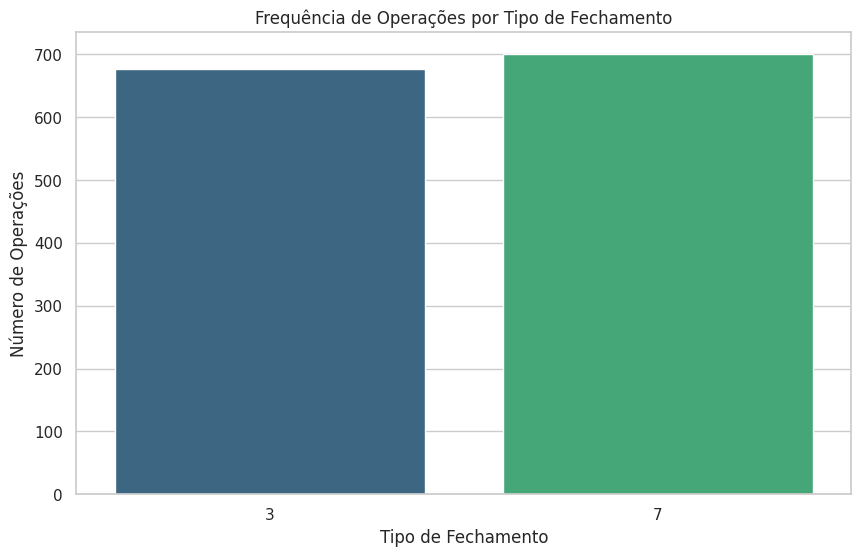

############################################################
# 2. Análise de Rentabilidade por Compra e Venda (SIGNAL_UP e SIGNAL_DOWN)
############################################################ 

Distribuição de operações de compra (em %):
SIGNAL_UP
7    50.835149
0    49.092229
1     0.072622
Name: proportion, dtype: float64

Média de pips ganhos/perdidos em operações de compra:
SIGNAL_UP
0        0.927663
1   -50000.750000
7      -72.767429
Name: result, dtype: float64

Tempo médio (em candles) das operações de compra:
SIGNAL_UP
0    241.272189
1      1.000000
7    236.381429
Name: count, dtype: float64

Distribuição de operações de venda (em %):
SIGNAL_DOWN
0    50.762527
3    49.164851
9     0.072622
Name: proportion, dtype: float64

Média de pips ganhos/perdidos em operações de venda:
SIGNAL_DOWN
0       -1.335908
3      -72.930059
9   -50003.400000
Name: result, dtype: float64

Tempo médio (em candles) das operações de venda:
SIGNAL_DOWN
0    236.718169
3    240.917282
9      

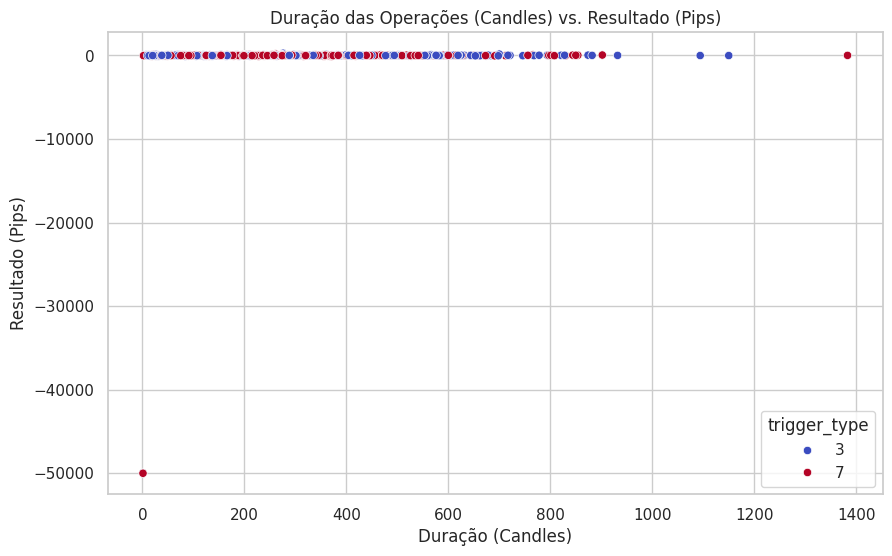

############################################################
# 6. Análise de Drawdown e Recuperação
############################################################ 

Maior drawdown subsequente: 101034.54999999997 pips

############################################################
# 7. Análise de Drawdown por Tipo de Fechamento
############################################################ 

Trigger Type 3:
  Maior drawdown subsequente: 100986.74999999997 pips

Trigger Type 7:
  Maior drawdown subsequente: 101034.54999999997 pips

############################################################
# 8. KPIs Principais
############################################################ 

Taxa de sucesso: 43.50%
Profit Factor: 0.16
Maior sequência de ganhos consecutivos: 8
Maior sequência de perdas consecutivas: 10

############################################################
# 9. Quantidade de Operações com Lucro e Perda
############################################################ 

Total de Operações com L

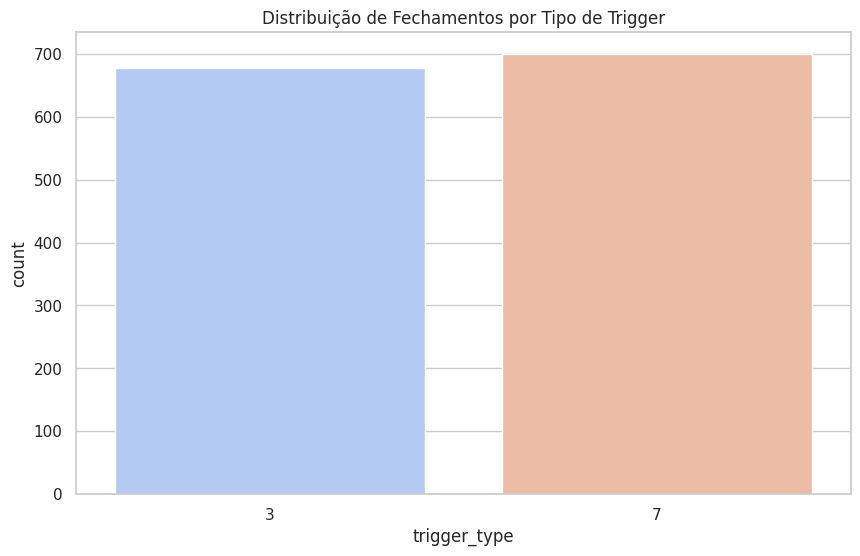

<Figure size 1000x600 with 0 Axes>

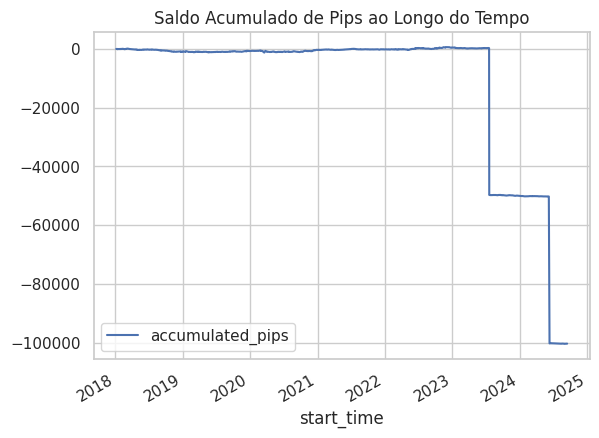

In [29]:
gerar_relatorio_completo(df_results)